![](https://img.shields.io/badge/Community-Contribution-%20?color=grey&labelColor=yellow)

> From the PO.DAAC Cookbook, to access the GitHub version of the notebook, follow [this link](https://github.com/podaac/tutorials/blob/master/notebooks/DataStories/SWOTHR_Science_Application.ipynb). 

_Note: This notebook uses Version C (2.0) of SWOT data that was available at the time of this notebook's development. The most recent data is now available as Version D for SWOT collections._
_The last Version C measurement will be until May 3rd, 2025. The first Version D measurement starts on May 5th, 2025._

# SWOT Hydrology Science Application Tutorial on the Cloud

## Retrieving SWOT attributes (WSE, width, slope) and plotting a longitudinal profile along a river or over a basin

### Requirement
This tutorial can only be run in an **AWS cloud instance running in us-west-2**: NASA Earthdata Cloud data in S3 can be directly accessed via `earthaccess` python library; this access is limited to requests made within the US West (Oregon) (code: `us-west-2`) AWS region.

### Earthdata Login

**An Earthdata Login account is required to access data**, as well as discover restricted data, from the NASA Earthdata system. Thus, to access NASA data, you need Earthdata Login. Please visit [https://urs.earthdata.nasa.gov](https://urs.earthdata.nasa.gov) to register and manage your Earthdata Login account. This account is free to create and only takes a moment to set up.

**This code runs using [SWOT Level 2 Data Products (Version C, aka 2.0)](https://podaac.jpl.nasa.gov/SWOT?tab=mission-objectives&sections=about%2Bdata).**

_Notebook Authors: Arnaud Cerbelaud, Jeffrey Wade, NASA Jet Propulsion Laboratory - California Institute of Technology (Mar 2024)_

## Learning Objectives
1) Retrieve SWOT hydrological attributes on river reaches within the AWS cloud (Cal/Val data). Query reaches by:
    - River name
    - Spatial bounding box
    - Downstream tracing from reach id (e.g. headwater to outlet) for river longitudinal profiles
    - Upstream tracing from reach id (e.g. outlet to full river network) for watershed analysis 
2) Plot a time series of WSE, width, slope data on the filtered data
3) Visualize an interactive map of WSE, width, slope data on the filtered data

## Import Packages

In [1]:
import fiona
import xarray as xr
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import hvplot.xarray
import earthaccess

pd.set_option('display.max_columns', None) #make sure all columns displayed for shapefiles

## Authenticate
Authenticate your Earthdata Login (EDL) information using the `earthaccess` python package as follows:

In [2]:
earthaccess.login() # Login with your EDL credentials if asked

## 1. Retrieve SWOT hydrological attributes on river reaches within the AWS cloud (Cal/Val data)
#### What data should we download?
- Optional step: Get the [.kmz file](https://podaac.github.io/tutorials/quarto_text/SWOT.html#swot-spatial-coverage) of SWOT passes/swaths for the and import it into Google Earth for visualization
- Determine which pass number corresponds to the river/basin you want to look at!
#### Search for multiple days of data

In [3]:
# Enter pass number
pass_number    = ["341", "576", "298"]   #e.g. 341, 576, 298 for Connecticut in NA, "236", "514", "542", "085", "363", "057", "335", "029" for Rhine in EU
# Enter continent code
continent_code = "NA"     # e.g. "AF", "NA", "EU", "SI", "AS", "AU", "SA", "AR", "GR"

# Retrieves granulev and links list from the passes we want, in this case by passing to `earthdata.search_data` function the data collection shortname and temporal bounds
links_list = []
for p in range(len(pass_number)):
    river_results = earthaccess.search_data(short_name = 'SWOT_L2_HR_RIVERSP_2.0', 
                                        temporal = ('2024-01-25 00:00:00', '2024-03-29 23:59:59'),
                                        granule_name = "*Reach*_" + pass_number[p] + "_" + continent_code + "*")
    for r in range(len(river_results)):
        river_link = earthaccess.results.DataGranule.data_links(river_results[r], access='direct')[0]
        links_list.append(river_link)

Granules found: 2
Granules found: 3
Granules found: 3


In [4]:
# Create fiona session to read data from zip files without download and extraction
fs_s3 = earthaccess.get_s3fs_session(results=river_results)
fiona_session=fiona.session.AWSSession(
        aws_access_key_id=fs_s3.storage_options["key"],
        aws_secret_access_key=fs_s3.storage_options["secret"],
        aws_session_token=fs_s3.storage_options["token"]
    )

In [5]:
links_list

['s3://podaac-swot-ops-cumulus-protected/SWOT_L2_HR_RiverSP_2.0/SWOT_L2_HR_RiverSP_Reach_010_341_NA_20240206T041926_20240206T041927_PIC0_01.zip',
 's3://podaac-swot-ops-cumulus-protected/SWOT_L2_HR_RiverSP_2.0/SWOT_L2_HR_RiverSP_Reach_011_341_NA_20240227T010431_20240227T010433_PIC0_01.zip',
 's3://podaac-swot-ops-cumulus-protected/SWOT_L2_HR_RiverSP_2.0/SWOT_L2_HR_RiverSP_Reach_010_576_NA_20240214T133056_20240214T133057_PIC0_01.zip',
 's3://podaac-swot-ops-cumulus-protected/SWOT_L2_HR_RiverSP_2.0/SWOT_L2_HR_RiverSP_Reach_011_576_NA_20240306T101600_20240306T101602_PIC0_01.zip',
 's3://podaac-swot-ops-cumulus-protected/SWOT_L2_HR_RiverSP_2.0/SWOT_L2_HR_RiverSP_Reach_012_576_NA_20240327T070054_20240327T070055_PIC0_01.zip',
 's3://podaac-swot-ops-cumulus-protected/SWOT_L2_HR_RiverSP_2.0/SWOT_L2_HR_RiverSP_Reach_010_298_NA_20240204T150846_20240204T150850_PIC0_01.zip',
 's3://podaac-swot-ops-cumulus-protected/SWOT_L2_HR_RiverSP_2.0/SWOT_L2_HR_RiverSP_Reach_011_298_NA_20240225T115352_20240225

#### Unzip selected files in Fiona session

In [6]:
# Initialize list of shapefiles containing all dates
SWOT_HR_shps = []

# Loop through queried granules to stack all acquisition dates
for j in range(len(links_list)):
    
    # We use the zip+ prefix so fiona knows that we are operating on a zip file
    river_shp_url = f"zip+{links_list[j]}"
    
    # Read shapefile
    with fiona.Env(session=fiona_session):
        SWOT_HR_shps.append(gpd.read_file(river_shp_url)) 

#### Aggregate unzipped files into dataframe

In [7]:
# Combine granules from all acquisition dates into one dataframe
SWOT_HR_df = gpd.GeoDataFrame(pd.concat(SWOT_HR_shps, ignore_index=True))

# Sort dataframe by reach_id and time
SWOT_HR_df = SWOT_HR_df.sort_values(['reach_id', 'time'])

SWOT_HR_df

,reach_id,time,time_tai,time_str,p_lat,p_lon,river_name,wse,wse_u,wse_r_u,wse_c,wse_c_u,slope,slope_u,slope_r_u,slope2,slope2_u,slope2_r_u,width,width_u,width_c,width_c_u,area_total,area_tot_u,area_detct,area_det_u,area_wse,d_x_area,d_x_area_u,layovr_val,node_dist,loc_offset,xtrk_dist,dschg_c,dschg_c_u,dschg_csf,dschg_c_q,dschg_gc,dschg_gc_u,dschg_gcsf,dschg_gc_q,dschg_m,dschg_m_u,dschg_msf,dschg_m_q,dschg_gm,dschg_gm_u,dschg_gmsf,dschg_gm_q,dschg_b,dschg_b_u,dschg_bsf,dschg_b_q,dschg_gb,dschg_gb_u,dschg_gbsf,dschg_gb_q,dschg_h,dschg_h_u,dschg_hsf,dschg_h_q,dschg_gh,dschg_gh_u,dschg_ghsf,dschg_gh_q,dschg_o,dschg_o_u,dschg_osf,dschg_o_q,dschg_go,dschg_go_u,dschg_gosf,dschg_go_q,dschg_s,dschg_s_u,dschg_ssf,dschg_s_q,dschg_gs,dschg_gs_u,dschg_gssf,dschg_gs_q,dschg_i,dschg_i_u,dschg_isf,dschg_i_q,dschg_gi,dschg_gi_u,dschg_gisf,dschg_gi_q,dschg_q_b,dschg_gq_b,reach_q,reach_q_b,dark_frac,ice_clim_f,ice_dyn_f,partial_f,n_good_nod,obs_frac_n,xovr_cal_q,geoid_hght,geoid_slop,solid_tide,load_tidef,load_tideg,pole_tide,dry_trop_c,wet_trop_c,iono_c,xovr_cal_c,n_reach_up,n_reach_dn,rch_id_up,rch_id_dn,p_wse,p_wse_var,p_width,p_wid_var,p_n_nodes,p_dist_out,p_length,p_maf,p_dam_id,p_n_ch_max,p_n_ch_mod,p_low_slp,geometry
3738,72120300121,-1.000000e+12,-1.000000e+12,no_data,50.355053,-77.287576,no_data,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,12582912,12582912,3,469762048,-1.000000e+12,2,-999,1,-999,-1.000000e+12,2,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,1,1,"72120300206, no_data, no_data, no_data","72120300113, no_data, no_data, no_data",248.199997,0.031587,45.0,217.523,86,228174.350,17135.322465,-1.000000e+12,0,1,1,0,"LINESTRING (-77.37319 50.31698, -77.37277 50.3..."
4454,72120300121,-1.000000e+12,-1.000000e+12,no_data,50.355053,-77.287576,no_data,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,12582912,12582912,3,469762048,-1.000000e+12,2,-999,1,-999,-1.000000e+12,2,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1

## Exploring the dataset

#### What acquisition dates and rivers do our downloaded files cover?

In [9]:
print('Available dates are:')
print(np.unique([i[:10] for i in SWOT_HR_df['time_str']]))
print('Available rivers are:')
print(np.unique([i for i in SWOT_HR_df['river_name']]))

Available dates are:
['2024-02-04' '2024-02-06' '2024-02-14' '2024-02-25' '2024-02-27'
 '2024-03-06' '2024-03-17' '2024-03-27' 'no_data']
Available rivers are:
['Androscoggin River' 'Batten Kill' 'Bras du Nord' 'Canal de fuite'
 "Chenal de l'Est" 'Concord River' 'Concord River; Sudbury River'
 'Connecticut River' 'Connecticut River; Westfield River'
 'Connecticut River; White River' 'Deerfield River' 'Farmington River'
 'Fleuve Saint-Laurent' 'Hoosic River' 'Housatonic River' 'Howells River'
 'Hudson River' 'Hudson River; Indian River' 'Indian River'
 'Komaktorvik River' 'La Grande River' 'Lac Saint-Louis' 'Lamoille River'
 'Magalloway River' 'Merrimack River' 'Missisquoi River' 'Mohawk River'
 'Ottawa River' 'Otter Creek' 'Passumsic River' 'Pemigewasset River'
 'Quinebaug River' 'Racquette River' 'Sacandaga River' 'Saguenay River'
 'Saint Lawrence River' 'Saint Regis River'
 'Saint Regis River; West Branch of the Saint Regis R' 'Shetucket River'
 'South Nation River' 'Sudbury River' '

#### Filter dataframe by river name of interest and plot selected reaches:
_Note: Some rivers have multiple names, hence using the `contains` function_

In [10]:
# Enter river name
river = "Connecticut River"  # e.g. "Rhine", "Connecticut River"

## Filter dataframe
SWOT_HR_df_river = SWOT_HR_df[(SWOT_HR_df.river_name.str.contains(river))]

# Plot geopandas dataframe with 'explore' by reach id
SWOT_HR_df_river[['reach_id','river_name','geometry']].explore('reach_id', style_kwds=dict(weight=6))

#### Filter dataframe by latitude/longitude of interest:

In [11]:
lat_start = {"Connecticut River": 41,
             "Rhine": 46.5
            }
lat_end   = {"Connecticut River": 45,
             "Rhine": 52
            }
lon_start = {"Connecticut River": -73,
             "Rhine": 6
            }
lon_end   = {"Connecticut River": -71,
             "Rhine": 10
            }

## Filter dataframe
SWOT_HR_df_box = SWOT_HR_df[(SWOT_HR_df.p_lat > lat_start[river]) & (SWOT_HR_df.p_lat < lat_end[river]) & (SWOT_HR_df.p_lon > lon_start[river]) & (SWOT_HR_df.p_lon < lon_end[river])]

# Plot geopandas dataframe with 'explore' by river name
SWOT_HR_df_box[['reach_id','river_name','geometry']].explore('river_name', style_kwds=dict(weight=6))



## 2. River longitudinal profile: trace reaches downstream of given starting reach using `rch_id_dn` field

_WARNING: This works as long as the data is exhaustive (no missing SWORD reaches)_



#### First, let's set up a dictionary relating all reaches in the dataset to their downstream neighbor

_Note: rch_dn_dict[rch_id] gives a list of all the reaches directly downstream from rch_id_

In [12]:
# Format rch_id_dn for dictionary. Rch_id_dn allows for multiple downstream reaches to be stored
# Also removes spaces in attribute field
rch_id_dn = [[x.strip() for x in SWOT_HR_df.rch_id_dn[j].split(',')] for j in range(0,len(SWOT_HR_df.rch_id_dn))]

# Filter upstream reach ids to remove 'no_data'
rch_id_dn_filter = [[x for x in dn_id if x.isnumeric()] for dn_id in rch_id_dn]

# Create lookup dictionary for river network topology: Downstream
rch_dn_dict = {SWOT_HR_df.reach_id[i]: rch_id_dn_filter[i] for i in range(len(SWOT_HR_df))}

#### Then, starting from a given reach, let's trace all connected downstream reaches

In [13]:
# Enter reach_id from which we will trace downstream    (e.g. headwaters of the Connecticut River)
rch_dn_st = {"Connecticut River": '73120000691',
             "Rhine": '23267000651'
            }

# Initialize list to store downstream reaches, including starting reach
rch_dn_list = [rch_dn_st[river]]
# Retrieve first downstream id of starting reach and add to list
rch_dn_next = rch_dn_dict[rch_dn_st[river]][0]

# Trace next downstream reach until we hit the outlet (or here the last reach on file)
while len(rch_dn_next) != 0:
    # Add reach to list if value exists
    if len(rch_dn_next) != 0:
        rch_dn_list.append(rch_dn_next)
    # Recursively retrieve first downstream id of next reach
    # Catch error if reach isn't in downloaded data
    try:
        rch_dn_next = rch_dn_dict[rch_dn_next][0]
    except:
        break

#### Finally, we filtered our downloaded data by the traced reaches to create a plot

In [14]:
# Filter downloaded data by downstream traced reaches
SWOT_dn_trace = SWOT_HR_df[SWOT_HR_df.reach_id.isin(rch_dn_list)]

# Remove reaches from rch_dn_list that are not present in SWOT data
rch_dn_list = [rch for rch in rch_dn_list if rch in SWOT_HR_df.reach_id.values]

SWOT_dn_trace[['reach_id','river_name','geometry']].explore('river_name', style_kwds=dict(weight=6))

### It looks like the data was cut short! 
Must be an error in the SWORD Database. Let's check by singling out the reach it left off on. 

It looks like reach '73120000531' at the time of this run (4/1/24) has 'no_data' in the `rch_id_up` and `rch_id_dn` fields when there should be values. To help out the SWORD database creators, we can report this discrepancy by clicking the `Report Reach` button at [https://www.swordexplorer.com/](https://www.swordexplorer.com/). SWORD should be updated quarterly.

In [16]:
SWOT_HR_df[SWOT_HR_df.reach_id == '73120000531']

,reach_id,time,time_tai,time_str,p_lat,p_lon,river_name,wse,wse_u,wse_r_u,wse_c,wse_c_u,slope,slope_u,slope_r_u,slope2,slope2_u,slope2_r_u,width,width_u,width_c,width_c_u,area_total,area_tot_u,area_detct,area_det_u,area_wse,d_x_area,d_x_area_u,layovr_val,node_dist,loc_offset,xtrk_dist,dschg_c,dschg_c_u,dschg_csf,dschg_c_q,dschg_gc,dschg_gc_u,dschg_gcsf,dschg_gc_q,dschg_m,dschg_m_u,dschg_msf,dschg_m_q,dschg_gm,dschg_gm_u,dschg_gmsf,dschg_gm_q,dschg_b,dschg_b_u,dschg_bsf,dschg_b_q,dschg_gb,dschg_gb_u,dschg_gbsf,dschg_gb_q,dschg_h,dschg_h_u,dschg_hsf,dschg_h_q,dschg_gh,dschg_gh_u,dschg_ghsf,dschg_gh_q,dschg_o,dschg_o_u,dschg_osf,dschg_o_q,dschg_go,dschg_go_u,dschg_gosf,dschg_go_q,dschg_s,dschg_s_u,dschg_ssf,dschg_s_q,dschg_gs,dschg_gs_u,dschg_gssf,dschg_gs_q,dschg_i,dschg_i_u,dschg_isf,dschg_i_q,dschg_gi,dschg_gi_u,dschg_gisf,dschg_gi_q,dschg_q_b,dschg_gq_b,reach_q,reach_q_b,dark_frac,ice_clim_f,ice_dyn_f,partial_f,n_good_nod,obs_frac_n,xovr_cal_q,geoid_hght,geoid_slop,solid_tide,load_tidef,load_tideg,pole_tide,dry_trop_c,wet_trop_c,iono_c,xovr_cal_c,n_reach_up,n_reach_dn,rch_id_up,rch_id_dn,p_wse,p_wse_var,p_width,p_wid_var,p_n_nodes,p_dist_out,p_length,p_maf,p_dam_id,p_n_ch_max,p_n_ch_mod,p_low_slp,geometry
866,73120000531,7.605090e+08,7.605090e+08,2024-02-06T04:29:59Z,44.224658,-72.054978,Connecticut River,154.0388,1.46533,1.46257,-1.000000e+12,-1.000000e+12,-0.005891,0.000053,0.000053,-0.006434,-1.000000e+12,0.896640,1392.178327,35.649174,-1.000000e+12,-1.000000e+12,15211862.6,389526.4859,15095057.3,389526.5,15211862.6,-1.000000e+12,-1.000000e+12,7.8523,105.676909,10.84167,9765.19336,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,25428408,25428408,2,540686,0.007679,2,-999,0,33,0.589286,0,-28.335190,9.845300e-07,0.172423,0.010426,0.010006,0.005676,-2.282196,-0.045801,-0.003250,0.121413,0,0,"no_data, no_data, no_data, no_data","no_data, no_data, no_data, no_data",126.700005,3.094431,127.0,3164.993,56,479601.479,11140.899379,-1.000000e+12,0,2,1,0,"LINESTRING (-72.05657 44.17983, -72.05663 44.1..."
2477,73120000531,7.612328e+08,7.612329e+08,2024-02-14T13:34:08Z,44.224658,-72.054978,Connecticut River,128.0371,0.32207,0.30924,-1.000000e+12,-1.000000e+12,0.000855,0.000167,0.000167,0.000768,-1.000000e+12,0.006689,236.948849,1.282518,-1.000000e+12,-1.000000e+12,2640563.8,14292.4126,2161135.3,14292.4,2640563.8,-1.000000e+12,-1.000000e+12,8.2052,54.052922,0.21296,-21062.49316,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,8389049,8389049,1,14,0.181563,2,-999,0,44,0.785714,1,-28.335581,2.610410e-06,-0.117483,-0.005037,-0.004920,0.005339,-2.264607,-0.021861,-0.006972,0.192579,0,0,"no_data, no_data, no_data, no_data","no_data, no_data, no_data, no_data",126.700005,3.094431,127.0,3164.993,56,479601.479,11140.899379,-1.000000e+12,0,2,1,0,"LINE



## 3. Watershed analysis: trace reaches upstream of starting reach using `rch_id_up` field

_WARNING: This works as long as the data is exhaustive (no missing SWORD reaches)_



#### First, let's set up a dictionary relating all reaches in the dataset to their upstream neighbor

_Note: rch_up_dict[rch_id] gives a list of all the reaches directly upstream from rch_id_

In [17]:
# Format rch_id_up for dictionary. Rch_id_up allows for multiple upstream reaches to be stored
# Also removes spaces in attribute field
rch_id_up = [[x.strip() for x in SWOT_HR_df.rch_id_up[j].split(',')] for j in range(0,len(SWOT_HR_df.rch_id_up))]

# Filter upstream reach ids to remove 'no_data'
rch_id_up_fil = [[x for x in ups_id if x.isnumeric()] for ups_id in rch_id_up]

# Create lookup dictionary for river network topology: Upstream
rch_up_dict = {SWOT_HR_df.reach_id[i]: rch_id_up_fil[i] for i in range(len(SWOT_HR_df))}

#### Then, starting from a given reach, let's trace all connected upstream reaches
This adds a bit of complexity, as we  need to keep track of multiple branches upstream of the starting reach.

In [18]:
# Enter reach_id from which we will trace upstream    (e.g. outlet of the Connecticut River)
rch_up_st = {"Connecticut River": '73120000021',
             "Rhine": '23265000051'
            }

# Initialize list to store traced upstream reaches, including starting reach
rch_up_list = [rch_up_st[river]]
# Retrieve ids of reaches upstream of starting reach and add to list
rch_up_next = rch_up_dict[rch_up_st[river]]
# For upstream tracing, we need to set a list of next upstream ids to start while loop
rch_next_id = rch_up_next

# Loop until no more reaches to trace
while len(rch_next_id) != 0:
    # Initialize list to store next upstream ids
    rch_next_id = []
    # Loop through next upstream ids for given reach
    for rch_up_sel in rch_up_next:
        # Get values of existing upstream ids of rch_up_next reaches
        # If reach isn't in SWOT data (usually ghost reaches), continue to next reach
        try:
            rch_next_id = rch_next_id + rch_up_dict[rch_up_sel]
        except:
            continue
        # Append id to list
        rch_up_list.append(rch_up_sel)
    # If reaches exist, add to list for next cycle of tracing
    if len(rch_next_id) != 0:
        rch_up_next = rch_next_id

#### Finally, we filtered our downloaded data by the traced reaches to create a plot

In [19]:
# Filter downloaded data by upstream traced reaches
SWOT_up_trace = SWOT_HR_df[SWOT_HR_df.reach_id.isin(rch_up_list)]

# Remove reaches from rch_up_list that are not present in SWOT data
rch_up_list = [rch for rch in rch_up_list if rch in SWOT_HR_df.reach_id.values]

SWOT_up_trace[['reach_id','river_name','geometry']].explore('river_name', style_kwds=dict(weight=6))

### It looks like the data was cut short! 
Must be an error in the SWORD Database. Let's check by singling out the reach it left off on. 

It looks like reach '73120000131' at the time of this run (4/1/24) has 'no_data' in the `rch_id_up` field when there should be values. To help out the SWORD database creators, we can report this discrepancy by clicking the `Report Reach` button at [https://www.swordexplorer.com/](https://www.swordexplorer.com/). SWORD should be updated quarterly.

In [20]:
SWOT_HR_df[SWOT_HR_df.reach_id == '73120000131']

,reach_id,time,time_tai,time_str,p_lat,p_lon,river_name,wse,wse_u,wse_r_u,wse_c,wse_c_u,slope,slope_u,slope_r_u,slope2,slope2_u,slope2_r_u,width,width_u,width_c,width_c_u,area_total,area_tot_u,area_detct,area_det_u,area_wse,d_x_area,d_x_area_u,layovr_val,node_dist,loc_offset,xtrk_dist,dschg_c,dschg_c_u,dschg_csf,dschg_c_q,dschg_gc,dschg_gc_u,dschg_gcsf,dschg_gc_q,dschg_m,dschg_m_u,dschg_msf,dschg_m_q,dschg_gm,dschg_gm_u,dschg_gmsf,dschg_gm_q,dschg_b,dschg_b_u,dschg_bsf,dschg_b_q,dschg_gb,dschg_gb_u,dschg_gbsf,dschg_gb_q,dschg_h,dschg_h_u,dschg_hsf,dschg_h_q,dschg_gh,dschg_gh_u,dschg_ghsf,dschg_gh_q,dschg_o,dschg_o_u,dschg_osf,dschg_o_q,dschg_go,dschg_go_u,dschg_gosf,dschg_go_q,dschg_s,dschg_s_u,dschg_ssf,dschg_s_q,dschg_gs,dschg_gs_u,dschg_gssf,dschg_gs_q,dschg_i,dschg_i_u,dschg_isf,dschg_i_q,dschg_gi,dschg_gi_u,dschg_gisf,dschg_gi_q,dschg_q_b,dschg_gq_b,reach_q,reach_q_b,dark_frac,ice_clim_f,ice_dyn_f,partial_f,n_good_nod,obs_frac_n,xovr_cal_q,geoid_hght,geoid_slop,solid_tide,load_tidef,load_tideg,pole_tide,dry_trop_c,wet_trop_c,iono_c,xovr_cal_c,n_reach_up,n_reach_dn,rch_id_up,rch_id_dn,p_wse,p_wse_var,p_width,p_wid_var,p_n_nodes,p_dist_out,p_length,p_maf,p_dam_id,p_n_ch_max,p_n_ch_mod,p_low_slp,geometry
4289,73120000131,7.603747e+08,7.603748e+08,2024-02-04T15:12:22Z,42.150023,-72.611327,Connecticut River; Westfield River,17.8123,1.75473,1.75242,-1.000000e+12,-1.000000e+12,0.000037,0.000070,0.000069,-0.001077,-1.000000e+12,0.149820,269.926514,0.917276,-1.000000e+12,-1.000000e+12,4913349.6,16696.7556,4020726.7,16696.8,4913349.6,-1.000000e+12,-1.000000e+12,7.4382,77.889768,3.07849,-17744.08203,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,8651194,8651194,2,524298,0.181673,1,-999,0,63,0.692308,1,-29.751362,0.000009,-0.086159,-0.000891,-0.001675,0.005661,-2.308405,-0.038409,-0.007717,-0.119022,0,1,"no_data, no_data, no_data, no_data","73120000121, no_data, no_data, no_data",11.400001,17.519935,283.0,3330.789,91,151626.309,18201.09844,-1.000000e+12,0,2,1,0,"LINESTRING (-72.58355 42.08302, -72.58318 42.0..."
826,73120000131,7.605090e+08,7.605090e+08,2024-02-06T04:29:28Z,42.150023,-72.611327,Connecticut River; Westfield River,12.6637,0.19421,0.17210,-1.000000e+12,-1.000000e+12,0.000114,0.000017,0.000017,0.000086,-1.000000e+12,0.001538,287.245279,0.797441,-1.000000e+12,-1.000000e+12,5228595.3,14515.4526,4606508.3,14515.5,5228595.3,-1.000000e+12,-1.000000e+12,9.1697,44.128698,1.25673,22611.02344,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,8651192,8651192,2,524302,0.118978,1,-999,0,79,0.868132,0,-29.758129,0.000009,0.174483,0.010891,0.010403,0.005627,-2.314298,-0.038225,-0.003412,0.275083,0,1,"no_data, no_data, no_data, no_data","73120000121, no_data, no_data, no_data",11.400001,17.519935,283.0,3330.789,91,151626.309,18201.09844,-1.

## 4. Visualize and plot a time series of WSE/width/slope longitudinal profiles

#### Let's create a time series dataframe from the downstream filtered database

In [21]:
# Retrieve all possible acquisition dates (keeping only YYYY-MM-DD)
dates = np.unique([i[:10] for i in [x for x in SWOT_HR_df['time_str'] if x!='no_data']])

# Create a new database for time series analysis with unique reach_ids
SWOT_dn_trace_time = SWOT_dn_trace.set_index('reach_id').groupby(level=0) \
                                  .apply(lambda df: df.reset_index(drop=True)) \
                                  .unstack().sort_index(axis=1, level=1)

SWOT_dn_trace_time.columns = ['{}_{}'.format(x[0],dates[x[1]]) for x in SWOT_dn_trace_time.columns]

#### Plot a longitudinal profile for selected SWOT variable

In [22]:
# Explore variables you could choose to plot
for var in ["wse","slope","width","len"]:
    print(SWOT_dn_trace.columns[SWOT_dn_trace.columns.str.contains(var)])

Index(['wse', 'wse_u', 'wse_r_u', 'wse_c', 'wse_c_u', 'area_wse', 'p_wse',
       'p_wse_var'],
      dtype='object')
Index(['slope', 'slope_u', 'slope_r_u', 'slope2', 'slope2_u', 'slope2_r_u'], dtype='object')
Index(['width', 'width_u', 'width_c', 'width_c_u', 'p_width'], dtype='object')
Index(['p_length'], dtype='object')


In [23]:
# Enter variable of interest for plotting
varstr = "wse"

The error that outputs the following cell is because of the SWORD database discrepancy noted above. When this is corrected, only the graph should appear without the error.

KeyError: 'wse_2024-03-06'

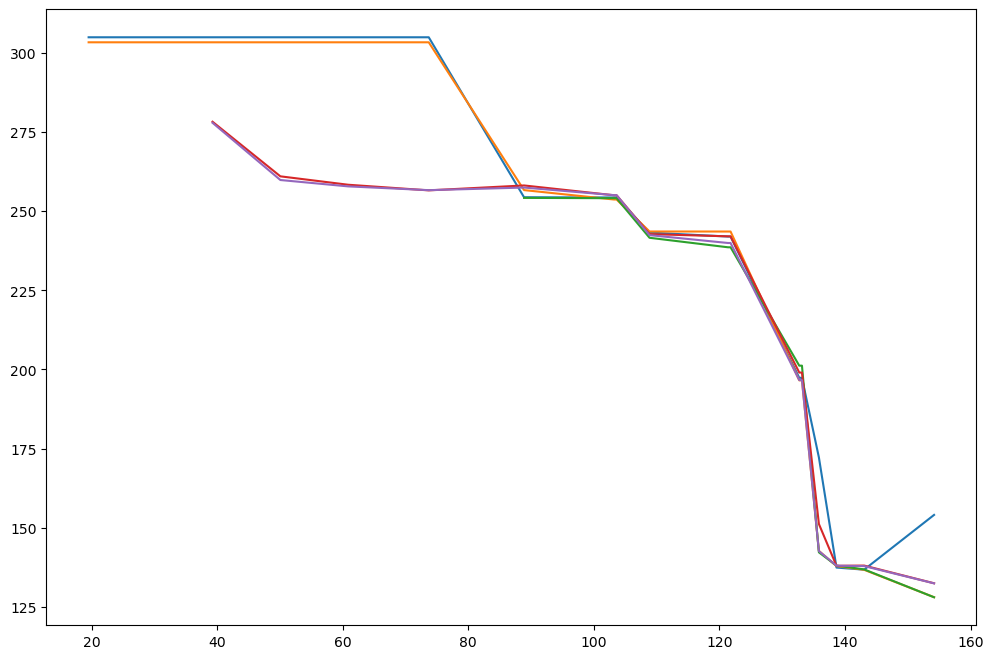

In [24]:
# Find cumulative length on the longitudinal profile
length_list    = np.nan_to_num([SWOT_dn_trace.p_length[SWOT_dn_trace.reach_id == rch].mean()/1000 for rch in rch_dn_list])
cumlength_list = np.cumsum(length_list)

## Plot a longitudinal profile from the downstream tracing database

## Plot a longitudinal profile from the downstream tracing database
plt.figure(figsize=(12,8))
for t in dates:
    
    # Store the quantity of interest (wse, width etc.) at time t
    value = SWOT_dn_trace_time.loc[rch_dn_list,varstr+'_'+t]
    
    # Remove set negative values (bad observations) to NaN and forward fill NaNs
    value[value < 0] = np.nan
    value = value.ffill()
    
    # Plot the data
    plt.plot(cumlength_list, value, label = varstr+'_'+t)
    
plt.xlabel('Downstream Distance (km)')
plt.ylabel(varstr)
plt.legend()

#### Map the longitudinal profile of selected SWOT variable

In [25]:
# Choose a date
date = dates[1]

In [26]:
#Set one column as the active geometry in the new database
SWOT_dn_trace_time = SWOT_dn_trace_time.set_geometry("geometry_"+date)

#Set cleaner colorbar bounds for better visualization
vmin = np.percentile([i for i in SWOT_dn_trace_time[varstr+'_'+date] if i>0],5)
vmax = np.percentile([i for i in SWOT_dn_trace_time[varstr+'_'+date] if i>0],95)

# Interactive map
SWOT_dn_trace_time.explore(varstr+'_'+date,
                           vmin = vmin,
                           vmax = vmax,
                           cmap = "Blues", #"Blues",
                           control_scale = True,
                           tooltip = varstr+'_'+dates[0],  # show "varstr+'_'+dates[0]" value in tooltip (on hover)
                           popup = True,  # show all values in popup (on click)
                           #tiles = "CartoDB positron",  # use "CartoDB positron" tiles
                           style_kwds=dict(weight=10)
                          )


## Supplemental



### We can also map the upstream traced database

In [27]:
SWOT_up_trace_time = SWOT_up_trace.set_index('reach_id').groupby(level=0) \
                                  .apply(lambda df: df.reset_index(drop=True)) \
                                  .unstack().sort_index(axis=1, level=1)

SWOT_up_trace_time.columns = ['{}_{}'.format(x[0],dates[x[1]]) for x in SWOT_up_trace_time.columns]

SWOT_up_trace_time = SWOT_up_trace_time.set_geometry("geometry_"+date)

#Set cleaner colorbar bounds for better visualization
vmin = np.percentile([i for i in SWOT_up_trace_time[varstr+'_'+date] if i>0],5)
vmax = np.percentile([i for i in SWOT_up_trace_time[varstr+'_'+date] if i>0],95)

# Interactive map
SWOT_up_trace_time.explore(varstr+'_'+date,
                           vmin = vmin,
                           vmax = vmax,
                           cmap = "Blues", #"Blues",
                           control_scale = True,
                           tooltip = varstr+'_'+dates[0],  # show "varstr+'_'+dates[0]" value in tooltip (on hover)
                           popup = True,  # show all values in popup (on click)
                           tiles = "CartoDB positron",  # use "CartoDB positron" tiles
                           style_kwds=dict(weight=5)
                          )

### How to filter out raster data to reveal water bodies?

We can also search by spatial bounding box. Raster tiles make it easy to do this since their footprints in the metadata are smaller. If you want the tile number, you can find it in the kmz file.

In [29]:
# Retrieve granules from all days to find the cycle corresponding to the desired date
raster_results = earthaccess.search_data(short_name = 'SWOT_L2_HR_Raster_100m_2.0', 
                                         temporal = ('2024-01-25 00:00:00', '2024-03-29 23:59:59'), 
                                         bounding_box = (-72.44, 42.27, -72.15, 42.54)) # Quabbin Reservoir in Massachusetts


Granules found: 11


#### Display details of accessed files

In [30]:
print([i for i in raster_results])

[Collection: {'Version': '2.0', 'ShortName': 'SWOT_L2_HR_Raster_100m_2.0'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'GPolygons': [{'Boundary': {'Points': [{'Latitude': 41.952112658860564, 'Longitude': -72.42544746840993}, {'Latitude': 41.952112658860564, 'Longitude': -70.53315398295408}, {'Latitude': 43.348708275316724, 'Longitude': -70.53315398295408}, {'Latitude': 43.348708275316724, 'Longitude': -72.42544746840993}, {'Latitude': 41.952112658860564, 'Longitude': -72.42544746840993}]}}], 'BoundingRectangles': [{'WestBoundingCoordinate': -72.42544746840993, 'SouthBoundingCoordinate': 41.952112658860564, 'EastBoundingCoordinate': -70.53315398295408, 'NorthBoundingCoordinate': 43.348708275316724}]}, 'Track': {'Cycle': 10, 'Passes': [{'Pass': 35, 'Tiles': ['228L', '229L', '230L', '231L', '228R', '229R', '230R', '231R']}]}}}
Temporal coverage: {'RangeDateTime': {'EndingDateTime': '2024-01-26T06:07:09.985Z', 'BeginningDateTime': '2024-01-26T06:06:48.882Z'}}
Size(MB): 92.3

#### Select a single file for visualization

#### Open file using xarray

In [31]:
ds_raster = xr.open_mfdataset(earthaccess.open([raster_results[1]]), engine='h5netcdf')
ds_raster

Opening 1 granules, approx size: 0.07 GB
using endpoint: https://archive.swot.podaac.earthdata.nasa.gov/s3credentials


QUEUEING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/1 [00:00<?, ?it/s]

<xarray.Dataset>
Dimensions:                  (x: 1574, y: 1574)
Coordinates:
  * x                        (x) float64 5.839e+05 5.84e+05 ... 7.412e+05
  * y                        (y) float64 4.645e+06 4.646e+06 ... 4.803e+06
Data variables: (12/39)
    crs                      object ...
    longitude                (y, x) float64 dask.array<chunksize=(525, 525), meta=np.ndarray>
    latitude                 (y, x) float64 dask.array<chunksize=(525, 525), meta=np.ndarray>
    wse                      (y, x) float32 dask.array<chunksize=(787, 787), meta=np.ndarray>
    wse_qual                 (y, x) float32 dask.array<chunksize=(1574, 1574), meta=np.ndarray>
    wse_qual_bitwise         (y, x) float64 dask.array<chunksize=(787, 787), meta=np.ndarray>
    ...                       ...
    load_tide_fes            (y, x) float32 dask.array<chunksize=(787, 787), meta=np.ndarray>
    load_tide_got            (y, x) float32 dask.array<chunksize=(787, 787), meta=np.ndarray>
    pole_tide                (y, x) float32 dask.array<chunksize=(787, 787), meta=np.ndarray>
    model_dry_tropo_cor      (y, x) float32 dask.array<chunksize=(787, 787), meta=np.ndarray>
    model_wet_tropo_cor      (y, x) float32 dask.array<chunksize=(787, 787), meta=np.ndarray>
    iono_cor_gim_ka          (y, x) float32 dask.array<chunksize=(787, 787), meta=np.ndarray>
Attributes: (12/49)
    Conventions:                   CF-1.7
    title:                         Level 2 KaRIn High Rate Raster Data Product
    source:                        Ka-band radar interferometer
    history:                       2024-02-08T18:43:05Z : Creation
    platform:                      SWOT
    references:                    V1.2.1
    ...                            ...
    x_min:                         583900.0
    x_max:                         741200.0
    y_min:                         4645400.0
    y_max:                         4802700.0
    institution:                   CNES
    product_version:               01

#### Plot raster data using custom filters to improve image quality

In [32]:
# Plot the data with a filter on water_frac > x, or sig0>50
ds_raster.wse.where(ds_raster.water_frac > 0.5).hvplot.image(y='y', x='x').opts(cmap='Blues', clim=(vmin,vmax), width=1000, height=750)

:Image   [x,y]   (wse)

To continue this analysis and mask data with quality flags, see the end of [this notebook](https://podaac.github.io/tutorials/notebooks/datasets/SWOT_Raster_Notebook_cloud.html).